# Accident data analysis in urban network
---
## 1. Accident data sample

In [30]:
import pandas as pd

The VicRoads crash metadata is on: [http://data.vicroads.vic.gov.au/Metadata/Crashes_Last_Five_Years%20-%20Open%20Data.html](http://data.vicroads.vic.gov.au/Metadata/Crashes_Last_Five_Years%20-%20Open%20Data.html)

In [34]:
## Obtain data from VicRoads website
#data = pd.read_csv('http://vicroadsopendata.vicroadsmaps.opendata.arcgis.com/datasets/c2a69622ebad42e7baaa8167daa72127_0.csv')

## Read the file downloaded
data = pd.read_csv('.\\_data\\Crashes_Last_Five_Years.csv')
data.head()

,X,Y,OBJECTID,ACCIDENT_NO,ABS_CODE,ACCIDENT_STATUS,ACCIDENT_DATE,ACCIDENT_TIME,ALCOHOLTIME,ACCIDENT_TYPE,...,DEG_URBAN_ALL,LGA_NAME_ALL,REGION_NAME_ALL,SRNS,SRNS_ALL,RMA,RMA_ALL,DIVIDED,DIVIDED_ALL,STAT_DIV_NAME
0,144.986525,-37.838321,3406744,T20130026785,ABS to receive accident,Finished,29/12/2013,02.20.00,Yes,Collision with vehicle,...,MELB_URBAN,"STONNINGTON,MELBOURNE","METROPOLITAN NORTH WEST REGION,METROPOLITAN SO...",NaN,NaN,Arterial Highway,"Arterial Highway,Arterial Other",Undivided,Undiv,Metro
1,145.640183,-37.777885,3406745,T20130026787,ABS to receive accident,Finished,29/12/2013,02.30.00,Yes,Collision with a fixed object,...,TOWNS,YARRA RANGES,METROPOLITAN SOUTH EAST REGION,B,B,Arterial Highway,"Arterial Highway,Local Road",Undivided,Undiv,Metro
2,145.944658,-36.540203,3406746,T20130026788,ABS to receive accident,Finished,28/12/2013,01.30.00,Yes,Collision with a fixed object,...,RURAL_VICTORIA,BENALLA,NORTH EASTERN REGION,NaN,NaN,Local Road,Local Road,Undivided,Undiv,Country
3,145.032323,-37.822255,3406747,T20130026790,ABS to receive accident,Finished,24/12/2013,14.00.00,No,Struck Pedestrian,...,MELB_URBAN,BOROONDARA,METROPOLITAN SOUTH EAST REGION,NaN,NaN,Arterial Other,"Arterial Other,Local Road",Undivided,Undiv,Metro
4,144.973157,-37.808115,3406748,T20130026791,ABS to receive accident,Finished,11/12/2013,14.30.00,No,Collision with vehicle,...,MELB_URBAN,MELBOURNE,METROPOLITAN NORTH WEST REGION,NaN,NaN,Arterial Other,"Arterial Other,Local Road",Divided,"Div,Undiv",Metro


In [35]:
print(data.shape)
data.columns

(74908, 65)


Index(['X', 'Y', 'OBJECTID', 'ACCIDENT_NO', 'ABS_CODE', 'ACCIDENT_STATUS',
       'ACCIDENT_DATE', 'ACCIDENT_TIME', 'ALCOHOLTIME', 'ACCIDENT_TYPE',
       'DAY_OF_WEEK', 'DCA_CODE', 'HIT_RUN_FLAG', 'LIGHT_CONDITION',
       'POLICE_ATTEND', 'ROAD_GEOMETRY', 'SEVERITY', 'SPEED_ZONE',
       'RUN_OFFROAD', 'NODE_ID', 'LONGITUDE', 'LATITUDE', 'NODE_TYPE',
       'LGA_NAME', 'REGION_NAME', 'VICGRID_X', 'VICGRID_Y', 'TOTAL_PERSONS',
       'INJ_OR_FATAL', 'FATALITY', 'SERIOUSINJURY', 'OTHERINJURY',
       'NONINJURED', 'MALES', 'FEMALES', 'BICYCLIST', 'PASSENGER', 'DRIVER',
       'PEDESTRIAN', 'PILLION', 'MOTORIST', 'UNKNOWN', 'PED_CYCLIST_5_12',
       'PED_CYCLIST_13_18', 'OLD_PEDESTRIAN', 'OLD_DRIVER', 'YOUNG_DRIVER',
       'ALCOHOL_RELATED', 'UNLICENCSED', 'NO_OF_VEHICLES', 'HEAVYVEHICLE',
       'PASSENGERVEHICLE', 'MOTORCYCLE', 'PUBLICVEHICLE', 'DEG_URBAN_NAME',
       'DEG_URBAN_ALL', 'LGA_NAME_ALL', 'REGION_NAME_ALL', 'SRNS', 'SRNS_ALL',
       'RMA', 'RMA_ALL', 'DIVIDED', 'DIVIDE

In [37]:
data['DATE-TIME'] = pd.to_datetime(data['ACCIDENT_DATE'] + ' ' + data['ACCIDENT_TIME'], format='%d/%m/%Y %H.%M.%S')
data.set_index('DATE-TIME', inplace=True)

In [50]:
## Filtering by date
data['2018']

,X,Y,OBJECTID,ACCIDENT_NO,ABS_CODE,ACCIDENT_STATUS,ACCIDENT_DATE,ACCIDENT_TIME,ALCOHOLTIME,ACCIDENT_TYPE,...,DEG_URBAN_ALL,LGA_NAME_ALL,REGION_NAME_ALL,SRNS,SRNS_ALL,RMA,RMA_ALL,DIVIDED,DIVIDED_ALL,STAT_DIV_NAME
DATE-TIME,,,,,,,,,,,,,,,,,,,,,
2018-01-05 08:45:00,144.361348,-38.143645,3462318,T20180000266,ABS to receive accident,Finished,5/1/2018,08.45.00,No,Collision with vehicle,...,LARGE_PROVINCIAL_CITIES,GEELONG,SOUTH WESTERN REGION,NaN,NaN,Local Road,Local Road,Undivided,Undiv,Country
2018-01-05 10:20:00,145.040880,-37.863999,3462319,T20180000267,ABS to receive accident,Finished,5/1/2018,10.20.00,No,Collision with vehicle,...,MELB_URBAN,STONNINGTON,METROPOLITAN SOUTH EAST REGION,NaN,NaN,Arterial Other,Arterial Other,Undivided,Undiv,Metro
2018-01-05 11:30:00,144.403089,-38.047470,3462321,T20180000272,ABS to receive accident,Finished,5/1/2018,11.30.00,No,Vehicle overturned (no collision),...,RURAL_VICTORIA,GEELONG,SOUTH WESTERN REGION,M,M,Freeway,Freeway,Divided,Div,Country
2018-01-05 10:20:00,145.157497,-38.112688,3462322,T20180000274,ABS to receive accident,Finished,5/1/2018,10.20.00,No,Collision with vehicle,...,MELB_URBAN,FRANKSTON,METROPOLITAN SOUTH EAST REGION,NaN,NaN,Arterial Highway,"Arterial Highway,Arterial Other",Divided,"Div,Undiv",Metro
2018-01-05 09:54:00,145.589601,-38.606214,3462323,T20180000276,ABS to receive accident,Finished,5/1/2018,09.54.00,No,Struck Pedestrian,...,TOWNS,BASS COAST,"EASTERN REGION,EASTERN REGION",C,C,Arterial Other,Arterial Other,Undivided,Undiv,Country
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-10-08 17:00:00,145.943609,-38.164752,3476419,T20190001214,ABS to receive accident,Finished,8/10/2018,17.00.00,Yes,Collision with vehicle,...,SMALL_CITIES,BAW BAW,"EASTERN REGION,EASTERN REGION",NaN,NaN,Local Road,Local Road,Undivided,Undiv,Country
2018-10-19 04:00:00,145.578797,-38.558561,3476511,T20190003105,ABS to receive accident,Finished,19/10/2018,04.00.00,Yes,collision with some other object,...,RURAL_VICTORIA,BASS COAST,"EASTERN REGION,EASTERN REGION",NaN,NaN,Local Road,Local Road,Undivided,Undiv,Country
2018-12-31 22:00:00,145.049426,-38.241187,3476526,T20190001293,ABS to receive accident,Finished,31/12/2018,22.00.00,Yes,No collision and no object struck,...,MELB_URBAN,MORNINGTON PENINSULA,METROPOLITAN SOUTH EAST REGION,NaN,NaN,Local Road,Local Road,Undivided,Undiv,Metro


## Network analysis

In [6]:
import osmnx as ox 

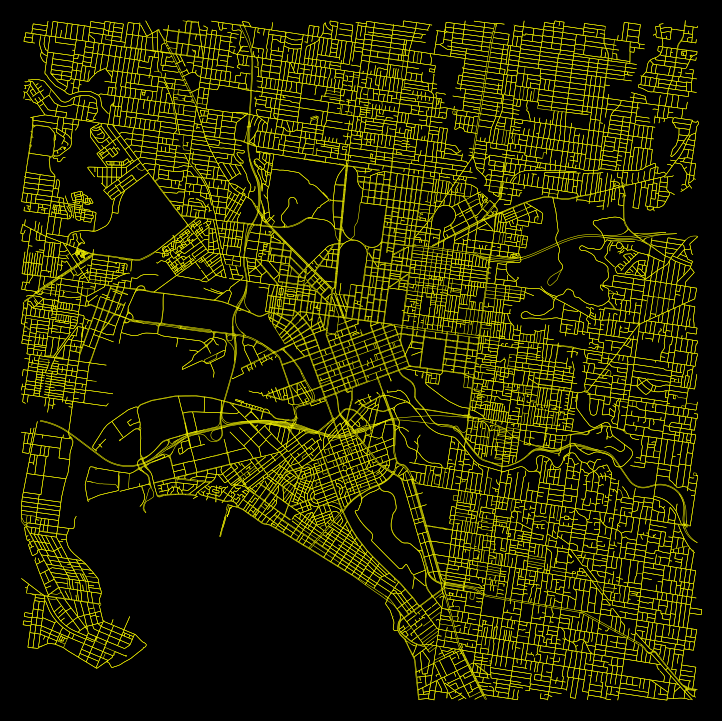

In [12]:
place = 'Melbourne, VIC, Australia'

G = ox.graph_from_address(place, distance=7000, network_type='drive', simplify=True)
fig, ax = ox.plot_graph(G, fig_height=13, node_size=0, edge_linewidth=0.5, bgcolor='black', edge_color='yellow')

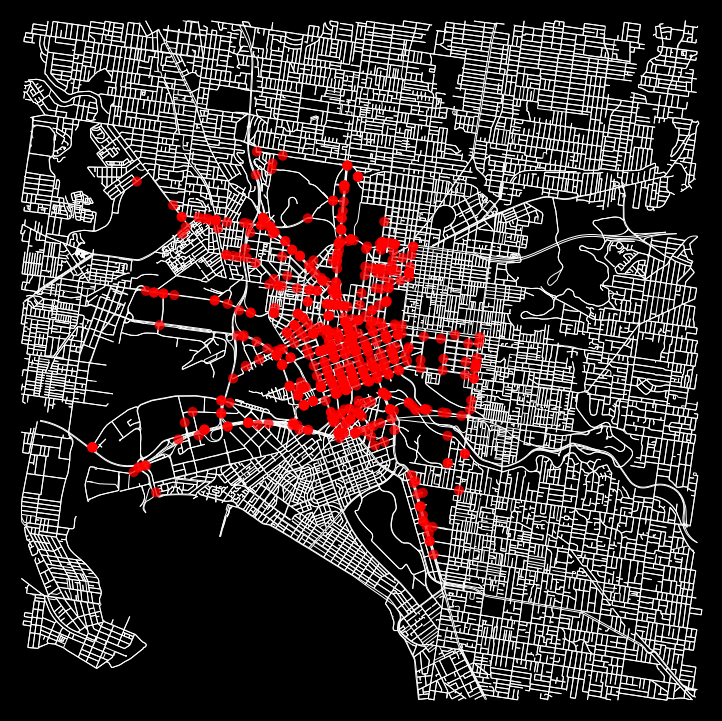

(<Figure size 1187.39x936 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1aae0e927f0>)

In [49]:
cond = data[(data['INJ_OR_FATAL'] > 0) & (data['LGA_NAME'] == 'MELBOURNE')]
cond = cond['2018']

locations = [[ox.get_nearest_node(G, (lat, lon))] for lat, lon in zip(cond['LATITUDE'], cond['LONGITUDE'])]

ox.plot_graph_routes(G, locations,
                    node_size=0, fig_height=13, bgcolor='k', edge_color='w')